## 1. Import the data and prepare variable names, dataframes, etc.

In [44]:
"""
File: CRAFTYPy.py
Author: Yongchao Zeng
Email: yongchao.zeng@kit.edu
Github: https://github.com/YcZen/CRAFTYPy.git
Description: This script implements the core of CRAFTY using pure dataframe operations, instead of ABM.
Date created: 2st August 2023
Last updated: 3rd August 2023
Python Version: 3.8
"""

import pandas as pd
import numpy as np
import random
import os
import matplotlib.pyplot as plt
from matplotlib import patches
from matplotlib.animation import FuncAnimation
from IPython.display import HTML


# capital_names = pd.read_csv(r"C:\data\CRAFTY data set\data_EUpaper_nocsv\csv\Capitals.csv")

# demand = pd.read_csv(r"C:\data\sampledInput\demand\demand.csv")

# base_map = pd.read_csv(r"C:\data\sampledInput\Baseline_map.csv")

# capital_path = r'C:\data\sampledInput\annualCapitals'

# AFT_path = r'C:\data\CRAFTY data set\data_EUpaper_nocsv\production'
##-------------------------------------------------------------------------------------------
capital_names = pd.read_csv(r"C:\data\CRAFTY data set\data_EUpaper_nocsv\csv\Capitals.csv")

demand = pd.read_csv(r"C:\data\CRAFTY data set\data_EUpaper_nocsv\worlds\EU\regionalisations\28\RCP2_6-SSP1\RCP2_6-SSP1_demands_EU.csv")

base_map = pd.read_csv(r"C:\data\CRAFTY data set\data_EUpaper_nocsv\worlds\EU\regionalisations\28\capitals\Baseline_map.csv")

capital_path = r'C:\data\CRAFTY data set\data_EUpaper_nocsv\worlds\EU\regionalisations\28\capitals\RCP2_6-SSP1'

AFT_path = r'C:\data\CRAFTY data set\data_EUpaper_nocsv\production'


capital_names = capital_names["Name"]


AFT_files = [file for file in os.listdir(AFT_path) if file.endswith('.csv')]

# Initialize an empty dictionary to store the DataFrames
AFTs = {}

#: Iterate through the CSV files and process each one
for file in AFT_files:
    # Construct the full file path
    file_path = os.path.join(AFT_path, file)
    
    # Read the CSV file
    df = pd.read_csv(file_path)
    
    # Save the DataFrame to the dictionary with the file name as the key
    key = file[:-4]
    AFTs[key] = df

#get the service names from a random AFT 
random_AFT_type = random.choice(list(AFTs.keys()))
random_AFT = AFTs[random_AFT_type]
service_names = list(random_AFT["Unnamed: 0"])

base_map[service_names] = np.nan



## 2. Define production functions

In [45]:
def calculate_production(row, capitals):
    # Extract the total factor productivity
    total_factor_productivity = row.iloc[-1]
    
    # Use the columns from row as the powers 
    powers = row[capital_names]#.iloc[1:-1]
    
    # Calculate the production for this row
    return total_factor_productivity * np.prod(np.power(capitals, powers))

def calculate_production_all(row):
    capitals = row[capital_names]
    
    AFT_name = row['FR']
    AFT = AFTs[AFT_name]
    
    # Pass 'capitals' to 'calculate_production'
    productions = AFT.apply(calculate_production, axis=1, args=(capitals,))
    
    for service_name, production in zip(service_names,productions):
        row[service_name] = production
    
    return row

## 3. Calculate initial production

In [46]:
base_map = base_map.apply(calculate_production_all,axis = 1)
#derive the initial productions
annual_productions = base_map[service_names].sum()

## 4. Define competition functions

In [47]:
def calculate_competitiveness(row, capitals):
    # Extract the total factor productivity
    total_factor_productivity = row.iloc[-1]
    
    # Use the remaining columns from row as the powers 
    powers = row[capital_names]#.iloc[1:-1]
    
    # Calculate the comepetitiveness for this row.
    return annual_utility * total_factor_productivity * np.prod(np.power(capitals, powers))

def calculate_winners(row):
    capitals = row[capital_names]
    #for each row, a random AFT should be selected
    # Get a random key
    random_AFT_type = random.choice(list(AFTs.keys()))
    # Get the corresponding value
    random_AFT = AFTs[random_AFT_type]
    #calculate the random AFT competitiveness
    random_AFT_competitiveness = random_AFT.apply(calculate_competitiveness, axis=1, args=(capitals,)).sum()
    random_AFT_competitiveness = random_AFT_competitiveness.sum()
    #get the current owner
    owner_AFT_type = row["FR"]
    owner_AFT = AFTs[owner_AFT_type]
    #calculate the competitiveness of the current owner
    owner_AFT_competitiveness = owner_AFT.apply(calculate_competitiveness, axis=1, args=(capitals,)).sum()
    owner_AFT_competitiveness = owner_AFT_competitiveness.sum()
    
    #update owner
    if random_AFT_competitiveness > owner_AFT_competitiveness:
        row["FR"] = random_AFT_type
    else:
        row["FR"] = owner_AFT_type
    
    # Calculate the production for this row
    return row

## 5. Mian simluation loop

In [48]:
capital_files = [file for file in os.listdir(capital_path) if file.endswith('.csv')]
simulation_results = []
l = []
total_utility = []
time = 0
# Iterate through the CSV files and process each one
for file in capital_files:
    
    # import capital files
    file_path = os.path.join(capital_path, file)
    annual_capital = pd.read_csv(file_path)
    # update capital
    base_map[capital_names] = annual_capital[capital_names]
    # update demand
    annual_demand = demand[service_names].iloc[time]

    #update utility
    annual_utility = annual_demand - annual_productions
    total_utility.append(annual_utility.sum())
    
    # randomly select lands and compete
    cell_compete = base_map.sample(frac=0.05)
    cell_compete = cell_compete.apply(calculate_winners, axis = 1)
    cell_compete = cell_compete.apply(calculate_production_all,axis = 1)
    
    #update cells where competition ocurred
    base_map.update(cell_compete)
    simulation_results.append(base_map[["x","y","FR"]])
    #update annual
    annual_productions = base_map[service_names].sum()
    l.append(annual_productions)
    #update time
    time += 1
    print(f"The {time}th year completed")
    if time >= demand.shape[0]:
        break

The 1th year completed
The 2th year completed
The 3th year completed
The 4th year completed
The 5th year completed
The 6th year completed
The 7th year completed
The 8th year completed
The 9th year completed
The 10th year completed
The 11th year completed
The 12th year completed
The 13th year completed
The 14th year completed
The 15th year completed
The 16th year completed
The 17th year completed
The 18th year completed
The 19th year completed
The 20th year completed
The 21th year completed
The 22th year completed
The 23th year completed
The 24th year completed
The 25th year completed
The 26th year completed
The 27th year completed
The 28th year completed
The 29th year completed
The 30th year completed
The 31th year completed
The 32th year completed
The 33th year completed
The 34th year completed
The 35th year completed
The 36th year completed
The 37th year completed
The 38th year completed
The 39th year completed
The 40th year completed
The 41th year completed
The 42th year completed
T

## Data visulization

In [49]:
dic = {}
for service in service_names:
    dic[service] = []
    for series in l:
        dic[service].append(series[service])

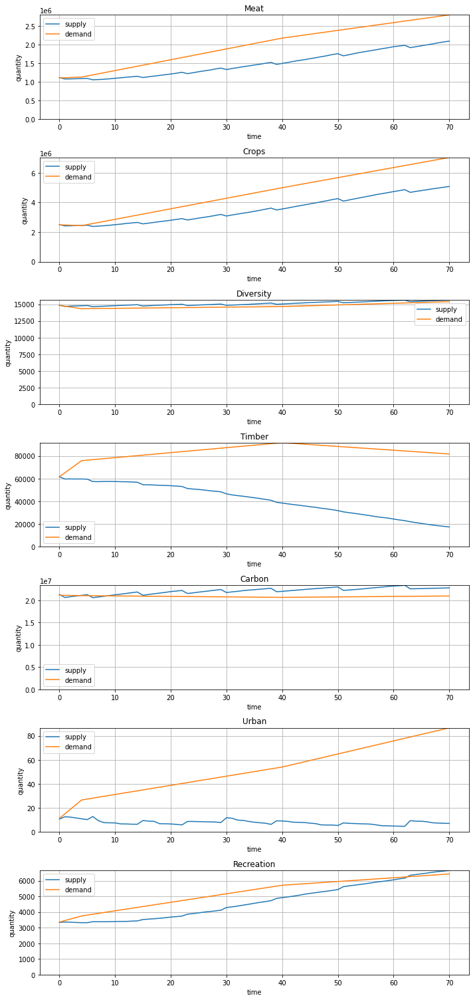

In [50]:
fig,axs = plt.subplots(len(service_names),1,figsize = (10,21))
for i, service in enumerate(service_names):
    axs[i].plot(dic[service],label = "supply")
    axs[i].plot(demand[service], label = "demand")
    axs[i].set_title(service)
    axs[i].set_ylim(0,max(max(dic[service]),max(demand[service])))
    axs[i].set_ylabel("quantity")
    axs[i].set_xlabel("time")
    axs[i].legend()
    axs[i].grid()
plt.tight_layout()

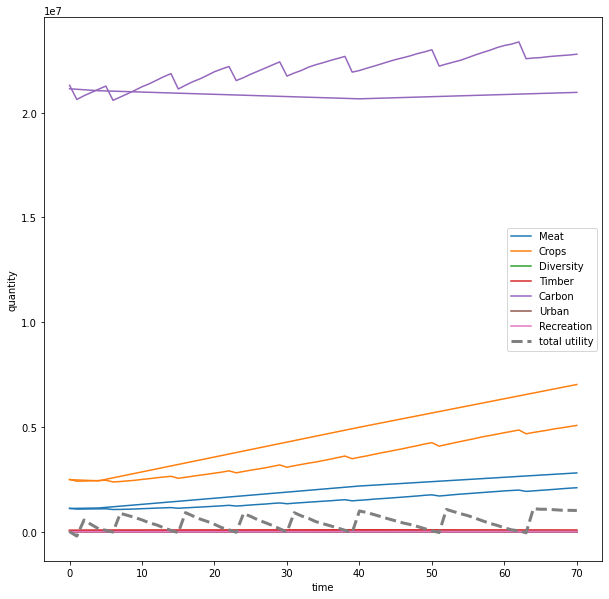

In [51]:
fig,ax = plt.subplots(figsize = (10,10))
for i, service in enumerate(service_names):
    line = ax.plot(dic[service],label = service)
    ax.plot(demand[service],c=line[0].get_color())
ax.plot(total_utility, label = "total utility", linewidth = 3, linestyle = "--")
ax.set_xlabel("time")
ax.set_ylabel("quantity")
ax.legend()

### Animate the results

In [58]:
def generate_random_color():
    # Generate a random color in hexadecimal format (e.g., '#RRGGBB')
    color = "#{:02x}{:02x}{:02x}".format(random.randint(0, 255), random.randint(0, 255), random.randint(0, 255))
    return color

# Create a mapping between FR types and colors
fr_colors = {}
for fr_type in base_map["FR"].unique():
    fr_colors[fr_type] = generate_random_color()

fig, ax = plt.subplots(figsize=(10,10))

# Create legend patches outside of the update function
legend_patches = [patches.Patch(color=color, label=fr_type) for fr_type, color in fr_colors.items()]

def update(frame):
    a_map = simulation_results[frame]
    ax.clear()
    
    # Create an empty image
    x_max, y_max = int(a_map['x'].max()), int(a_map['y'].max())
    image = np.zeros((x_max+1, y_max+1, 3), dtype=np.uint8)
    
    for fr_type, group in a_map.groupby("FR"):
        color = fr_colors[fr_type]
        # Convert the color from hex to RGB
        color_rgb = [int(color[i:i+2], 16) for i in (1, 3, 5)]

        # Fill the image at the x, y positions with the color
        image[group['x'].astype(int), group['y'].astype(int)] = color_rgb

    ax.set_title(f"The {frame + 1}th Year")
    # Add the legend to the plot, outside the plot box
    ax.legend(handles=legend_patches, bbox_to_anchor=(1.025, 1), loc='upper left')
    # The original image has to be rotated counterclockwise by 90 degrees to present a classic view. This might vary from data to data.
    image_rotated = np.rot90(image)
    ax.imshow(image_rotated)

animation = FuncAnimation(fig, update, frames=len(simulation_results), interval=500, repeat=False)
display(HTML(animation.to_jshtml()))
plt.close(fig)

Animation size has reached 21278456 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
